In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [2]:
# Required plotting setting
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
import matplotlib.pyplot as plt
plt.rc('font', family='serif')
plt.rc('font', serif='Arial')
#plt.style.use('default')

import seaborn as sns
_font_size = 7.5
sns.set_context("paper", rc={"font.size":_font_size,"axes.titlesize":_font_size+1,"axes.labelsize":_font_size})   

# 2. Load data

In [117]:
merlin_output_master_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human'
merlin_output_folders = [
    os.path.join(merlin_output_master_folder, r'20221023-hM1_hM1'),
    os.path.join(merlin_output_master_folder, r'20221025-hM1_hM1'),
    os.path.join(merlin_output_master_folder, r'20221026-hM1_hM1'),
]

save_folder = os.path.join(merlin_output_master_folder, 'hM1_hM1_summary')
print(f"save_folder is: {save_folder}")
if not os.path.exists(save_folder):
    os.makedirs(save_folder)
    
figure_folder = os.path.join(merlin_output_master_folder, 'hM1_hM1-Cx28_summary')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

sc.settings.figdir = figure_folder

save_folder is: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1_summary
Use figure_folder: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1-Cx28_summary


In [118]:

raw_filename = os.path.join(save_folder, 'raw_data.h5ad')

overwrite = False

if not os.path.exists(raw_filename) or overwrite:
    print(f"Start merging AnnData")
    adata_list = []
    for _data_folder in merlin_output_folders:

        cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
        cell_meta_data = pd.read_csv(cell_meta_data_file)
        counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
        df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
        for _c in df.columns:
            if 'Blank-' in _c:
                df = df.drop(columns=_c)
        adata = anndata.AnnData(df)
        adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
        adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
        # load postanalysis h5ad
        #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
        #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
        #_data = sc.read(_save_filename)
        adata_list.append(adata)
    # merge
    merged_adata = anndata.concat(adata_list, )
    print(f"save adata into file: {raw_filename}")
    merged_adata.write(raw_filename)
else:
    print(f"Directly load from: {raw_filename}")
    merged_adata = sc.read(raw_filename)

Directly load from: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1_summary\raw_data.h5ad


# 3. Preprocess and filter the MERFISH data 

In [119]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

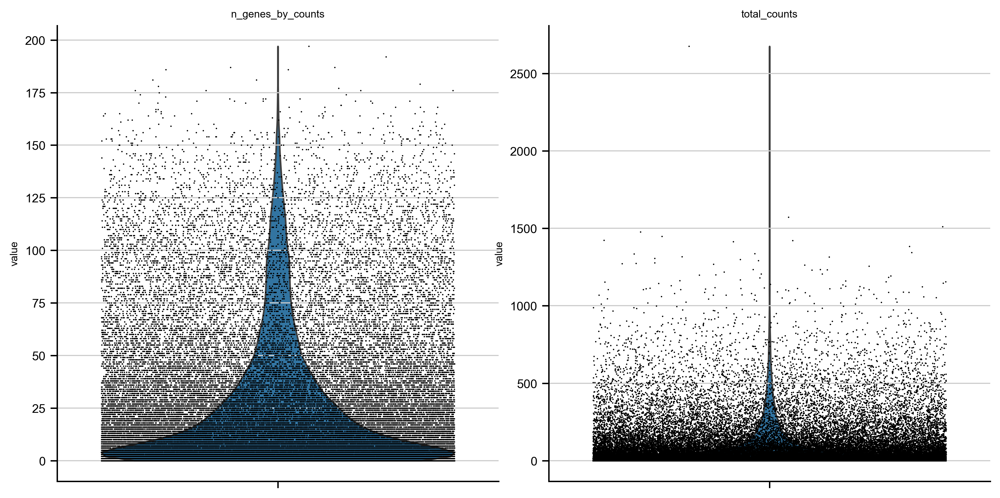

In [120]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_before_filter.png')

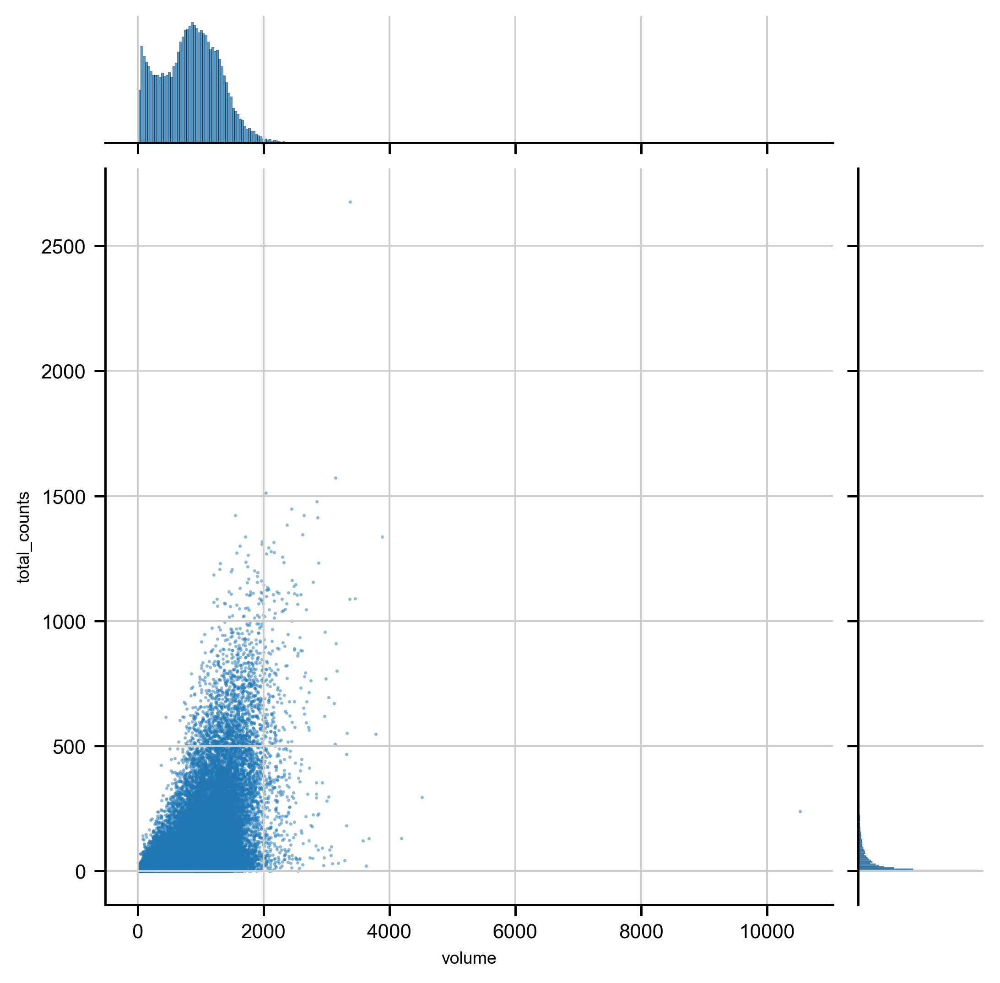

In [121]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts', s=2, linewidth=0, alpha=0.5)

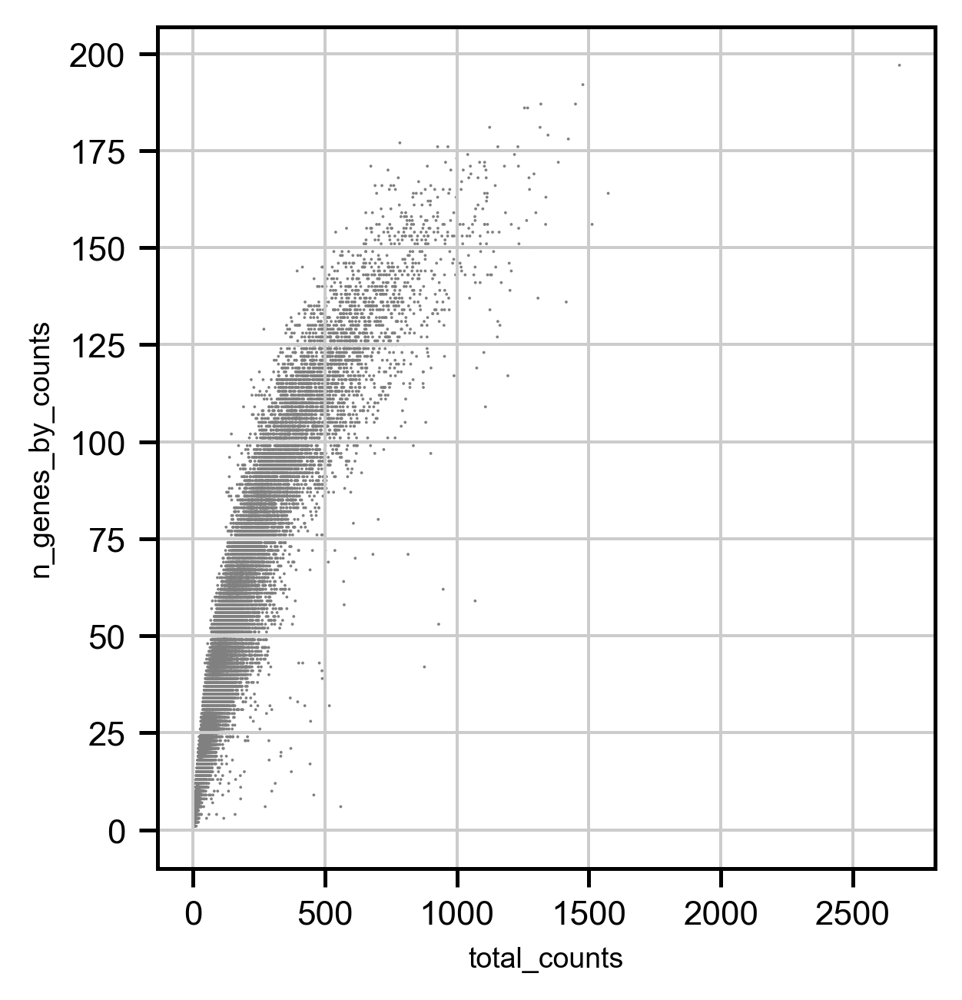

In [122]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [123]:
gene_count_threshold = 5
total_count_threshold = 10
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

33658


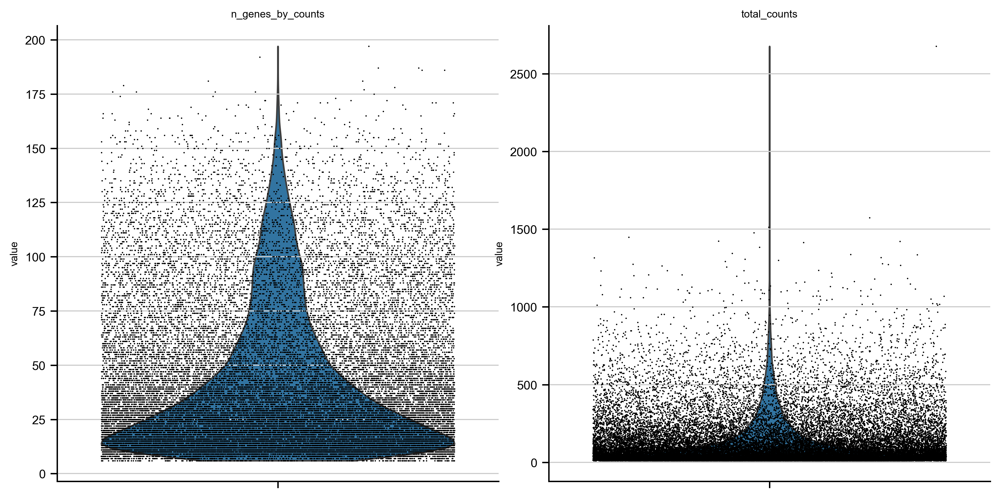

In [124]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True, save='_counts_after_filter.png')

## filter doublet

In [126]:
sc.external.pp.scrublet(merged_adata)

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


Automatically set threshold at doublet score = 0.63
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.0%


E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\external\pp\_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']


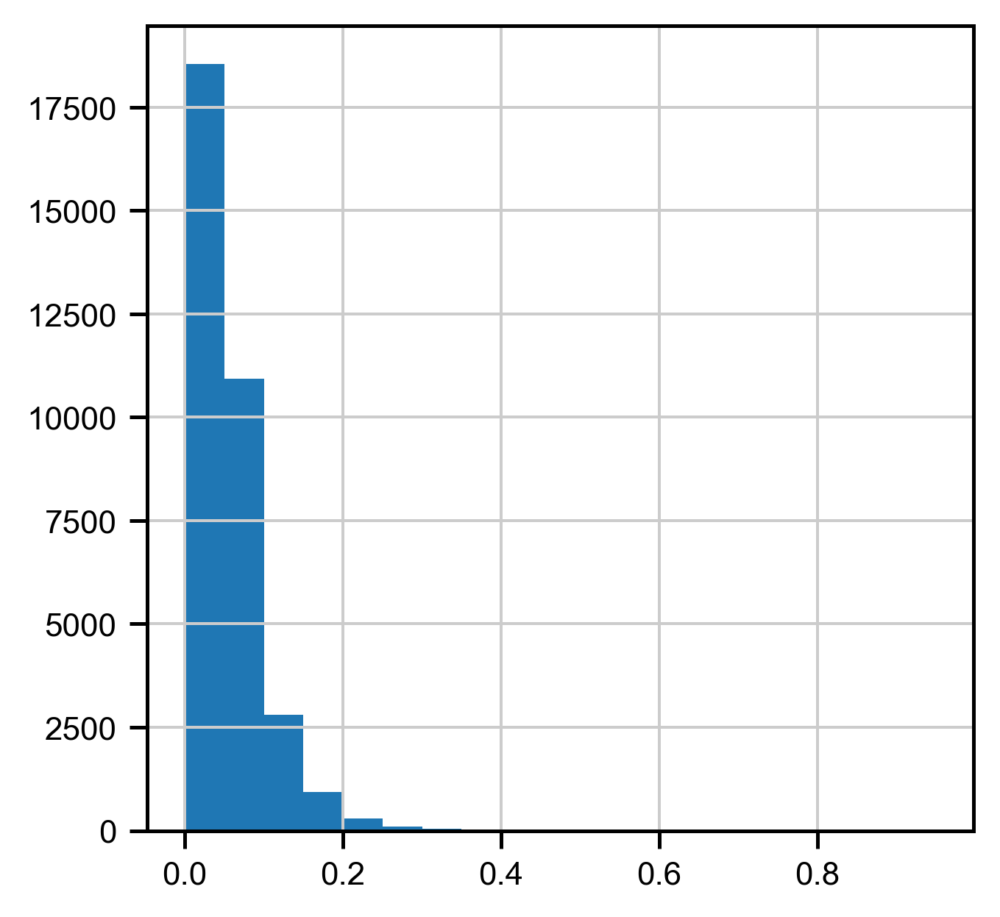

0.013399488977360508

In [127]:
plt.figure()
plt.hist(merged_adata.obs['doublet_score'], bins=np.arange(0,1,0.05))
plt.show()
np.mean(merged_adata.obs['doublet_score'] > 0.2)

In [128]:
# remove potential doublet
doublet_score_th = 0.2
merged_adata = merged_adata[merged_adata.obs['doublet_score'] <= doublet_score_th]
len(merged_adata)

33207

In [130]:
filtered_filename = os.path.join(save_folder, 'filtered_data.h5ad')

overwrite = False

if not os.path.exists(filtered_filename) or overwrite:
    print(f"save adata into file: {filtered_filename}")
    merged_adata.write(filtered_filename)
else:
    print(f"savefile: {filtered_filename} already exists")

save adata into file: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1_summary\filtered_data.h5ad


In [185]:
# load 
merged_adata = sc.read_h5ad(filtered_filename)

# 4. PCA and UMAP of the MERFISH data (for quick test)

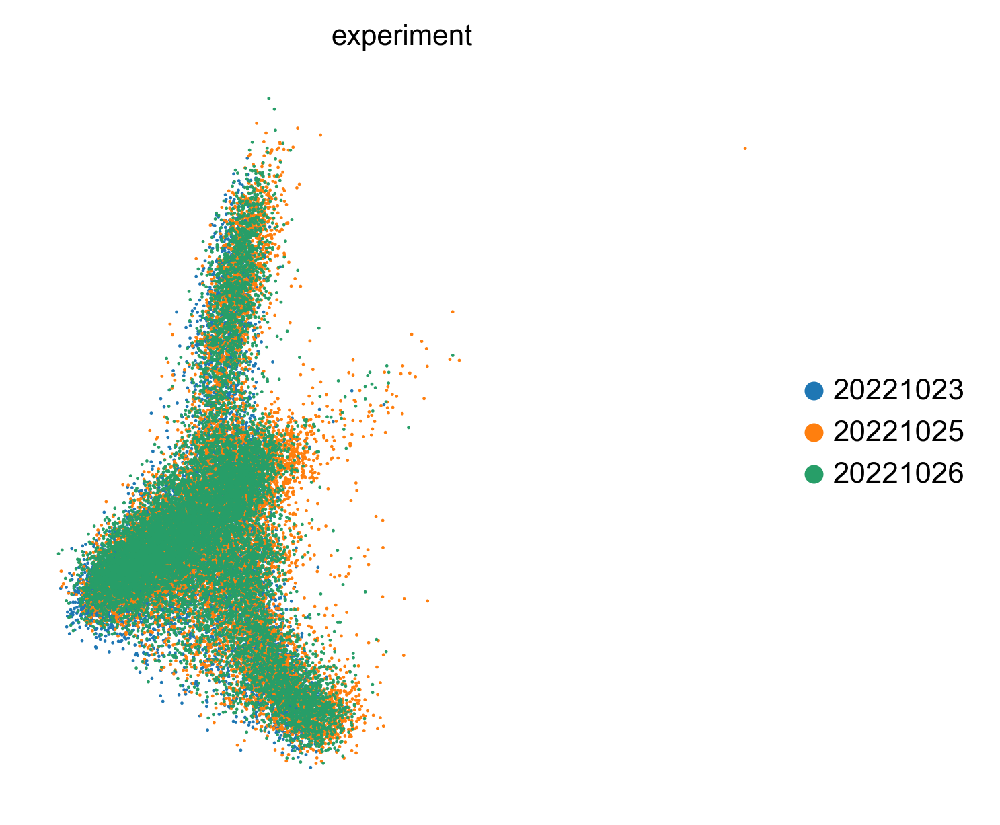

Wall time: 1min 13s


In [186]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata, color='experiment', save='_all_cells.png')

In [188]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=8, n_pcs=30)
# Clustering
sc.tl.leiden(merged_adata, resolution=0.8)

Wall time: 5.26 s


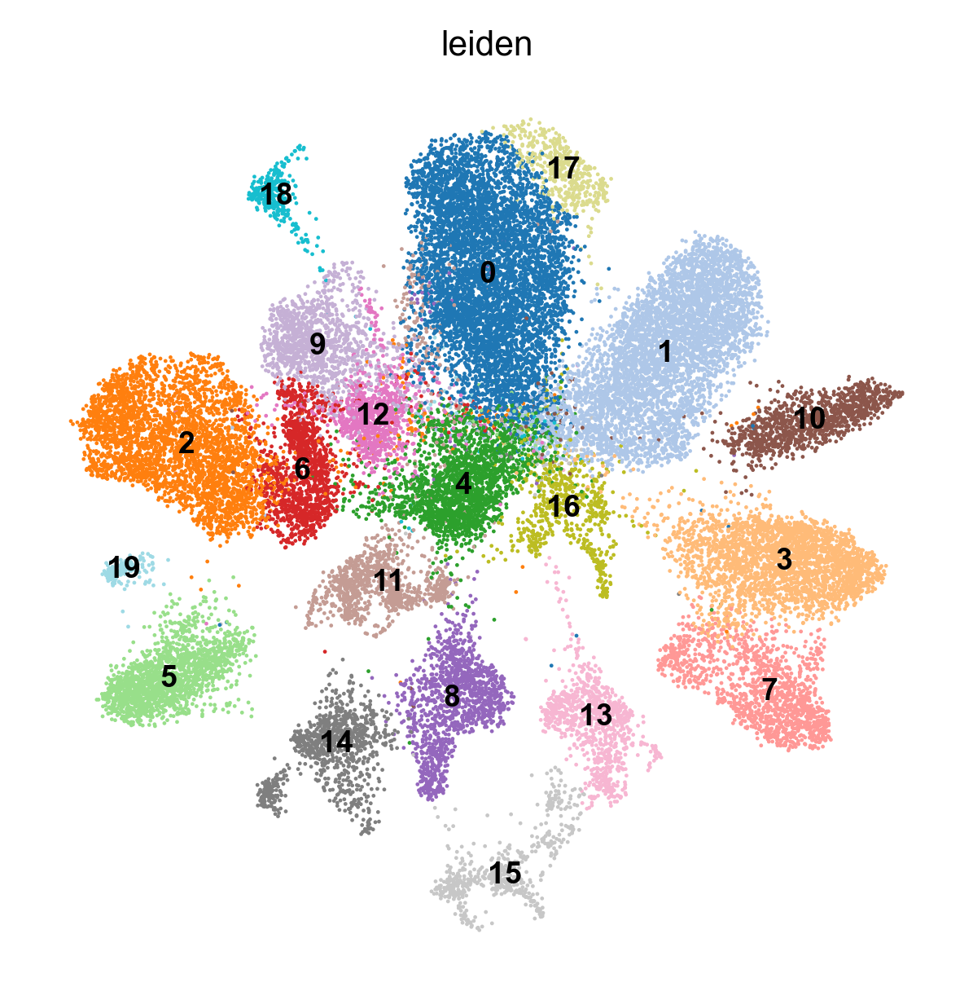

Wall time: 29.4 s


In [189]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', 
           legend_loc='on data',
           palette='tab20',
           save='_cluster.png',
           )

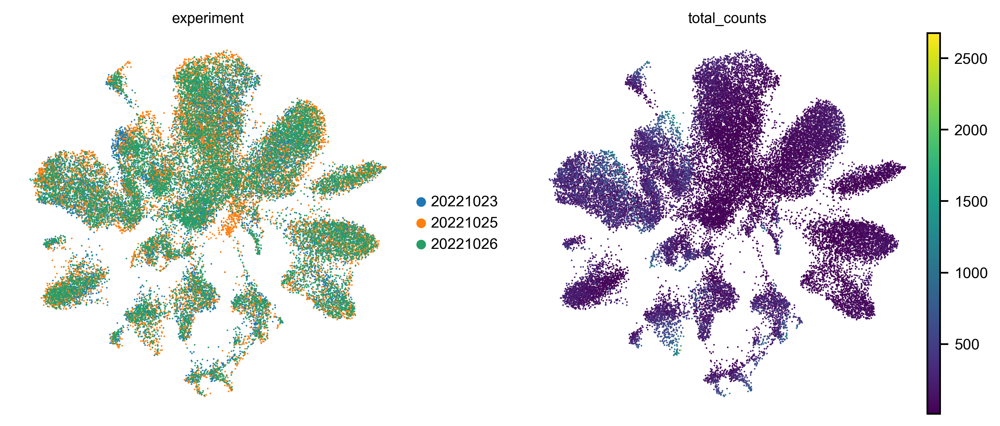

In [190]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color=['experiment', 'total_counts'], 
           save='_experiment_counts.png',)

# 5. Check count for each cell for genes of interest

In [191]:
# direcly use previous leiden
merged_adata.obs['leiden_cluster'] = merged_adata.obs.leiden

## T-test to identify marker genes

E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
E:\Users\puzheng_new\Anaconda3\envs\postanalysis\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

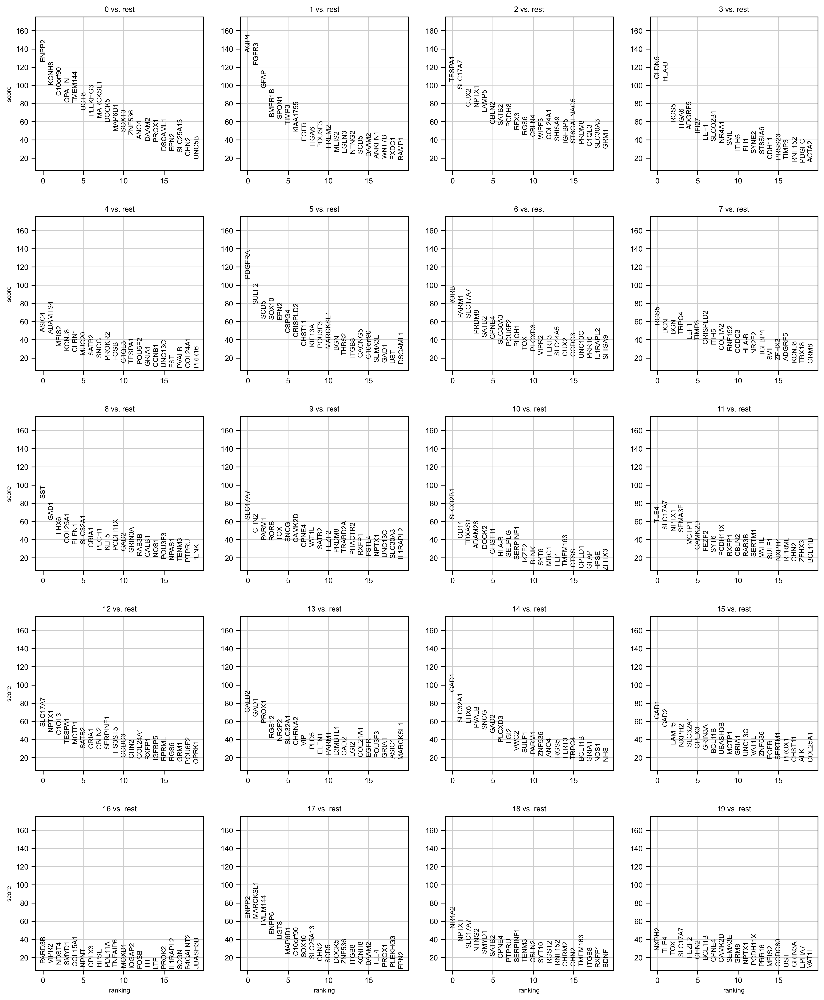

In [192]:
sc.tl.rank_genes_groups(merged_adata, groupby='leiden_cluster', method='t-test')
sc.pl.rank_genes_groups(merged_adata, groupby='leiden_cluster')

In [193]:
gene_ordering = np.array([list(_gnames) for _gnames in merged_adata.uns['rank_genes_groups']['names']])

In [194]:
# assign clusters
clusters = np.sort(np.unique(merged_adata.obs['leiden_cluster']).astype(np.int32))

# Inhibitory
inhibitory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='GAD1')[0] < 10:
        print(_i, end=', ')
        inhibitory_clusters.append(_i)
# excitatory
print("")
excitatory_clusters = []
for _i in clusters:
    if np.where(gene_ordering[:,_i]=='SLC17A7')[0] < 10:
        print(_i, end=', ')
        excitatory_clusters.append(_i)
nonneuron_clusters = []
for _i in clusters:
    if _i not in inhibitory_clusters and _i not in excitatory_clusters:
        nonneuron_clusters.append(_i)

8, 13, 14, 15, 
2, 6, 9, 11, 12, 18, 19, 

In [198]:
n_nonneu = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in nonneuron_clusters:
        n_nonneu += 1

print(n_nonneu / len(merged_adata.obs))
        

0.6270665823470954


In [196]:
n_gluta = 0
for _cls in merged_adata.obs['leiden_cluster']:
    if int(_cls) in excitatory_clusters:
        n_gluta += 1

print(n_gluta / len(merged_adata.obs))
        

0.2569638931550577


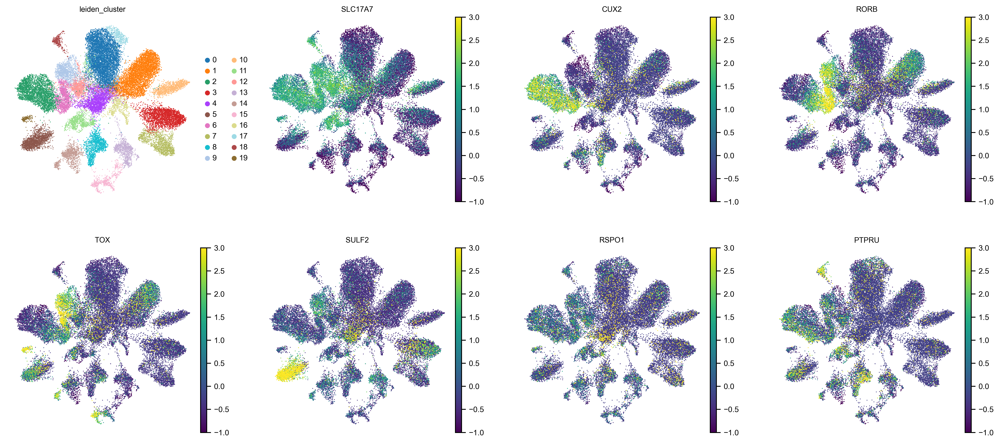

In [202]:
sc.pl.umap(merged_adata, color=['leiden_cluster', 'SLC17A7','CUX2','RORB', 'TOX', 'SULF2', 'RSPO1','PTPRU'],
           vmin=-1, vmax=3, save='_excitatory_gene.png')

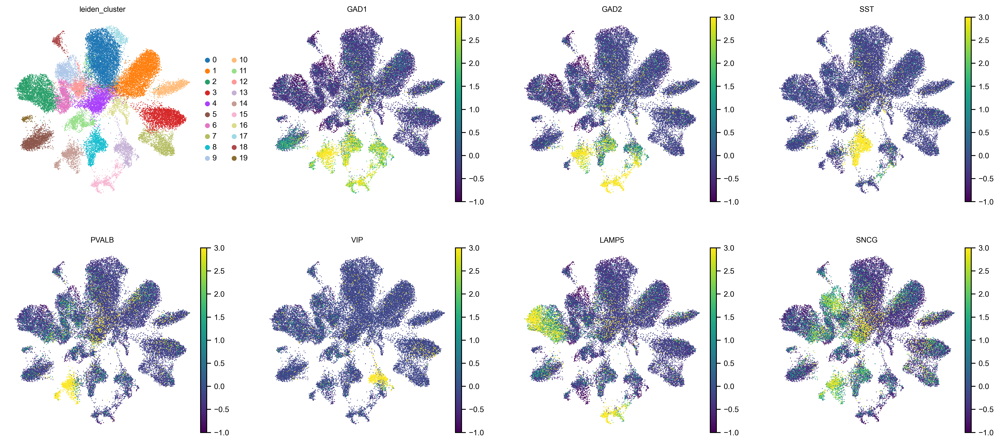

In [203]:
sc.pl.umap(merged_adata, color=['leiden_cluster', 'GAD1','GAD2','SST','PVALB','VIP','LAMP5','SNCG'],
           vmin=-1, vmax=3, save='_inhibitory_gene.png')

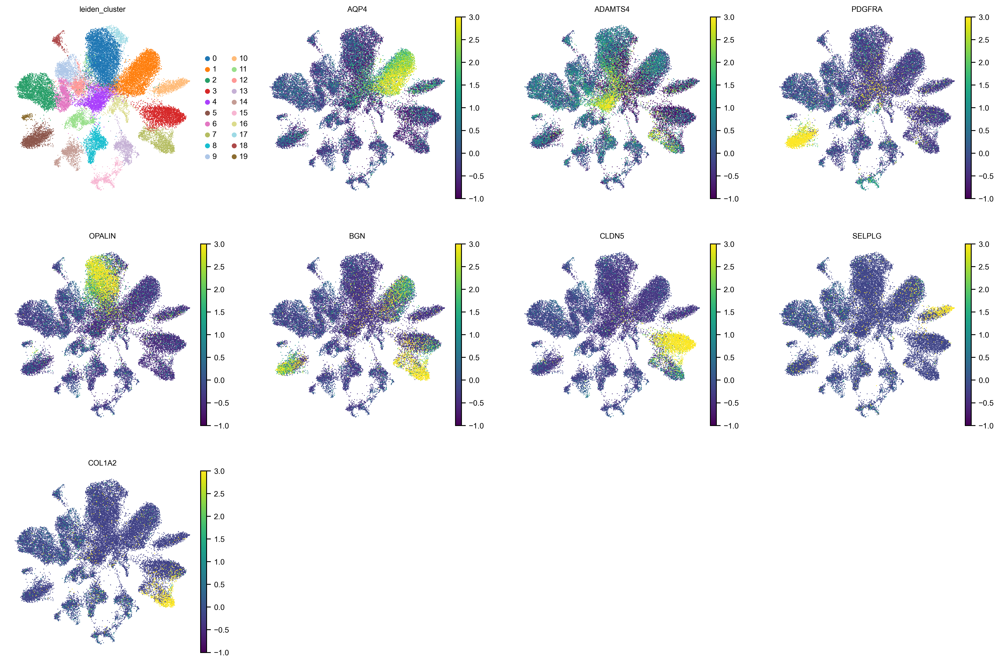

In [204]:
sc.pl.umap(merged_adata, color=['leiden_cluster', 'AQP4', 'ADAMTS4', 'PDGFRA', 'OPALIN', 'BGN', 'CLDN5', 'SELPLG','COL1A2'],
           vmin=-1, vmax=3, save='_nonneuron_gene.png')

In [205]:
experiments = list(np.unique(merged_adata.obs['experiment']))
print(experiments)

['20221023', '20221025', '20221026']


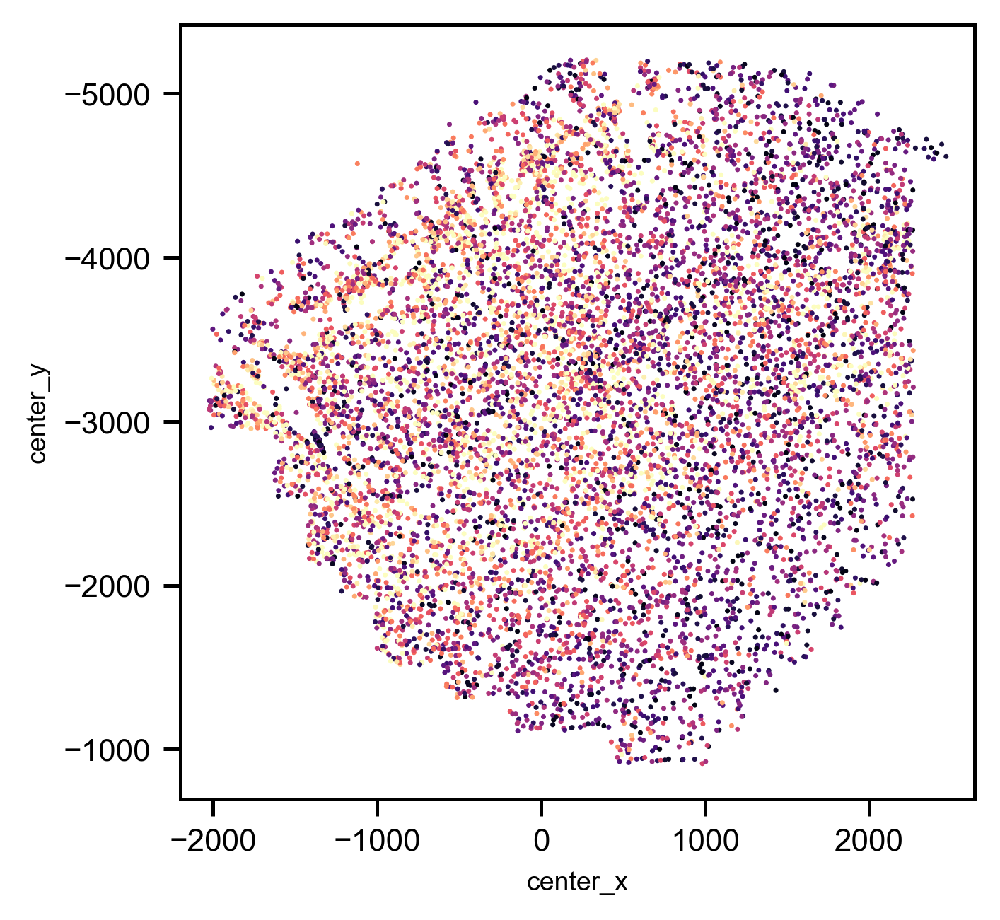

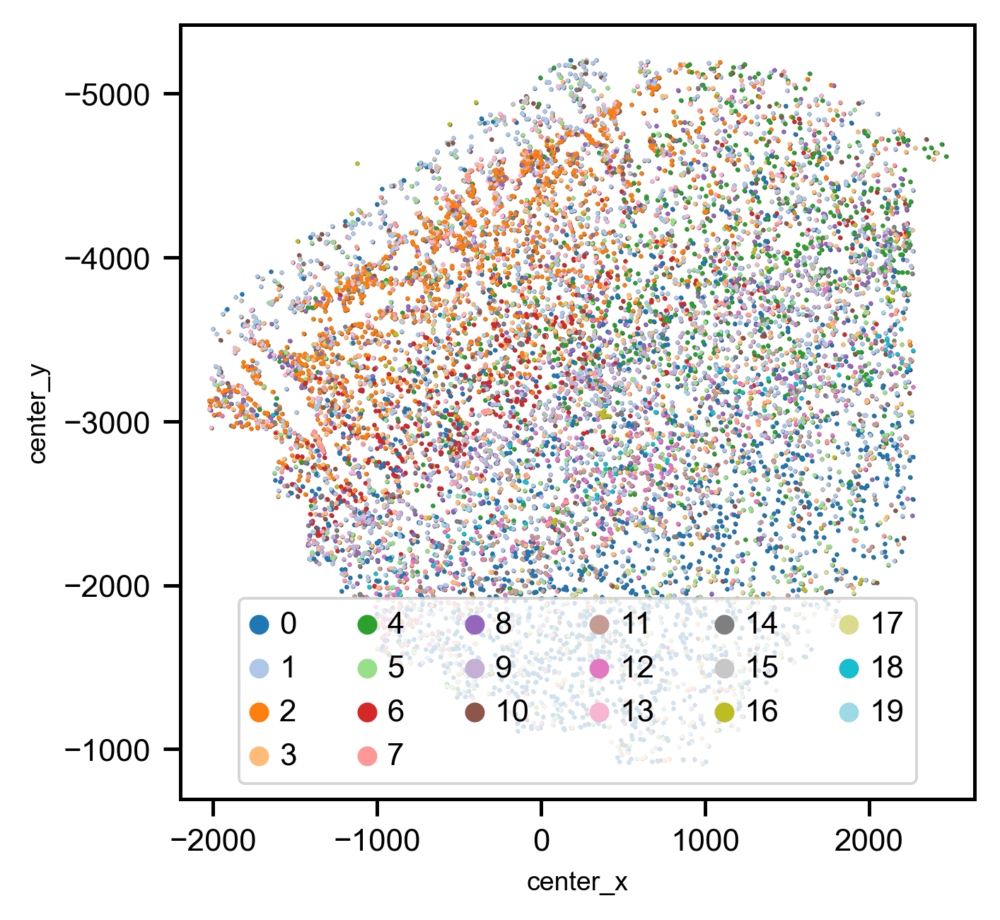

In [208]:
# visualzie the spatial dist for clusters
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
sel_experiment_id = 0
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]
#plt.style.use('dark_background')
ax = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                     hue='total_counts', hue_norm=LogNorm(vmin=10,vmax=200), 
                     palette='magma',
                     s=2, linewidth=0,
                     legend=False, )
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
#ax.legend(hs,ls, ncol=8, loc=8)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial-total_counts_{experiments[sel_experiment_id]}.png'), 
            transparent=True)
plt.show()

# visualzie the spatial dist for clusters
sel_clusters = np.unique(sel_obs['leiden_cluster'])

sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if _cls in sel_clusters]
ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.2,0.2,0.2], s=1.5, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='tab20',
                     hue='leiden', s=1.5, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=6, loc=8)

plt.savefig(os.path.join(figure_folder, f'spatial-all_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


## 6.1 plot different subtypes

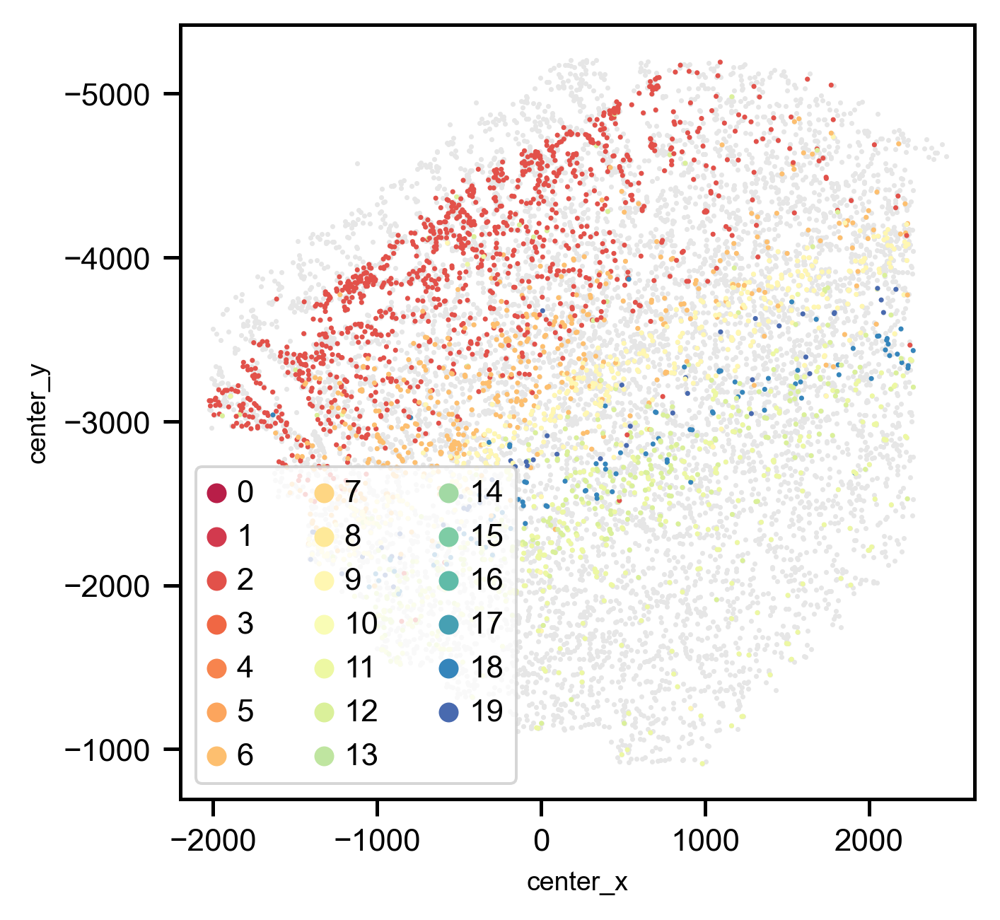

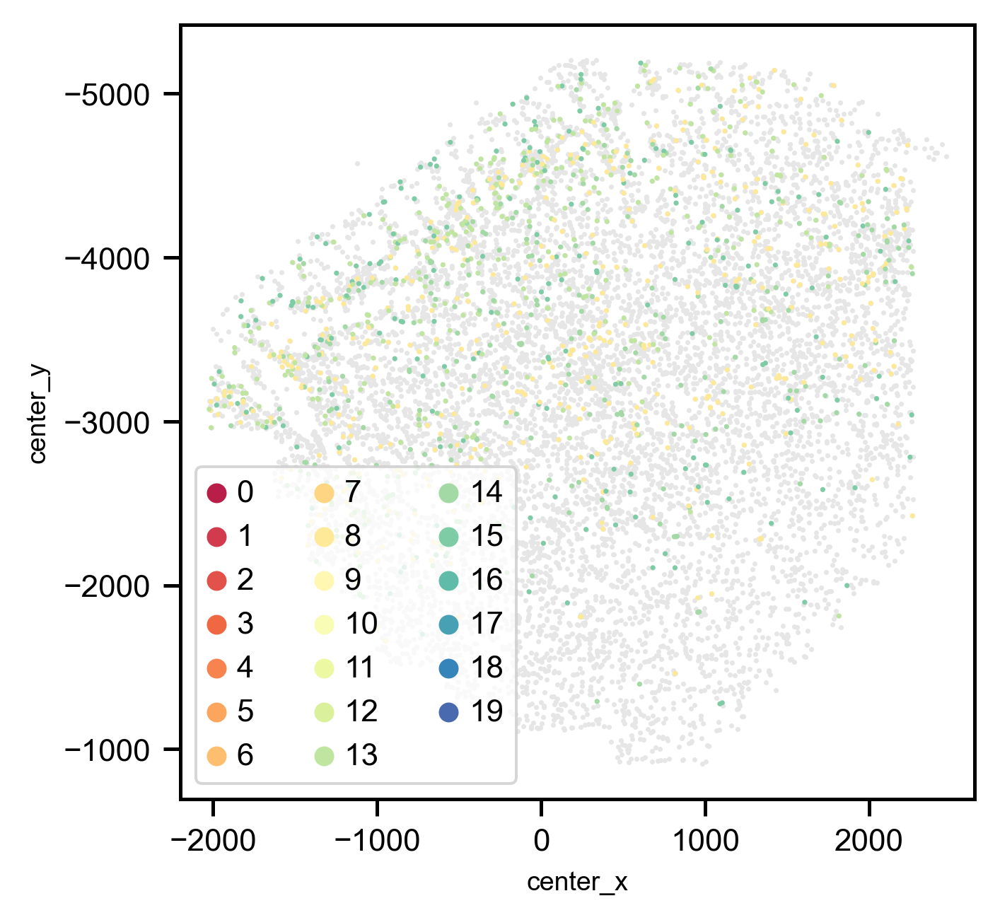

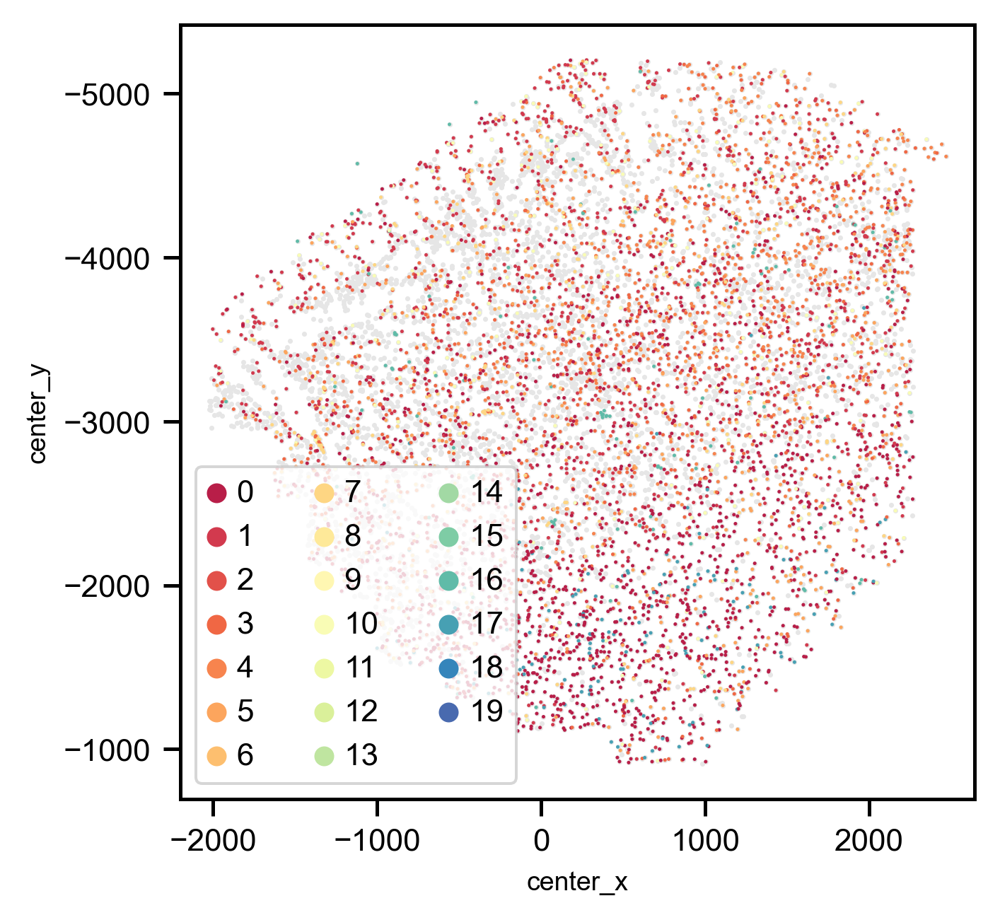

In [209]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [210]:
sel_experiment_id = 1
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

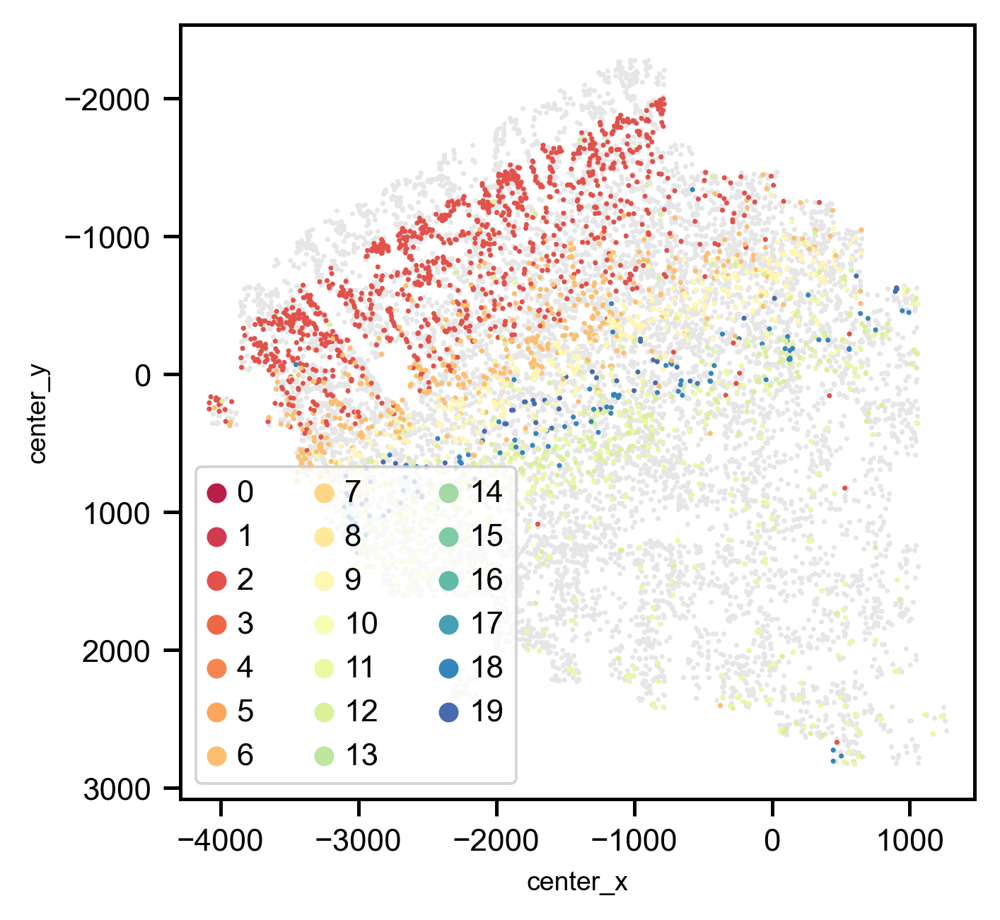

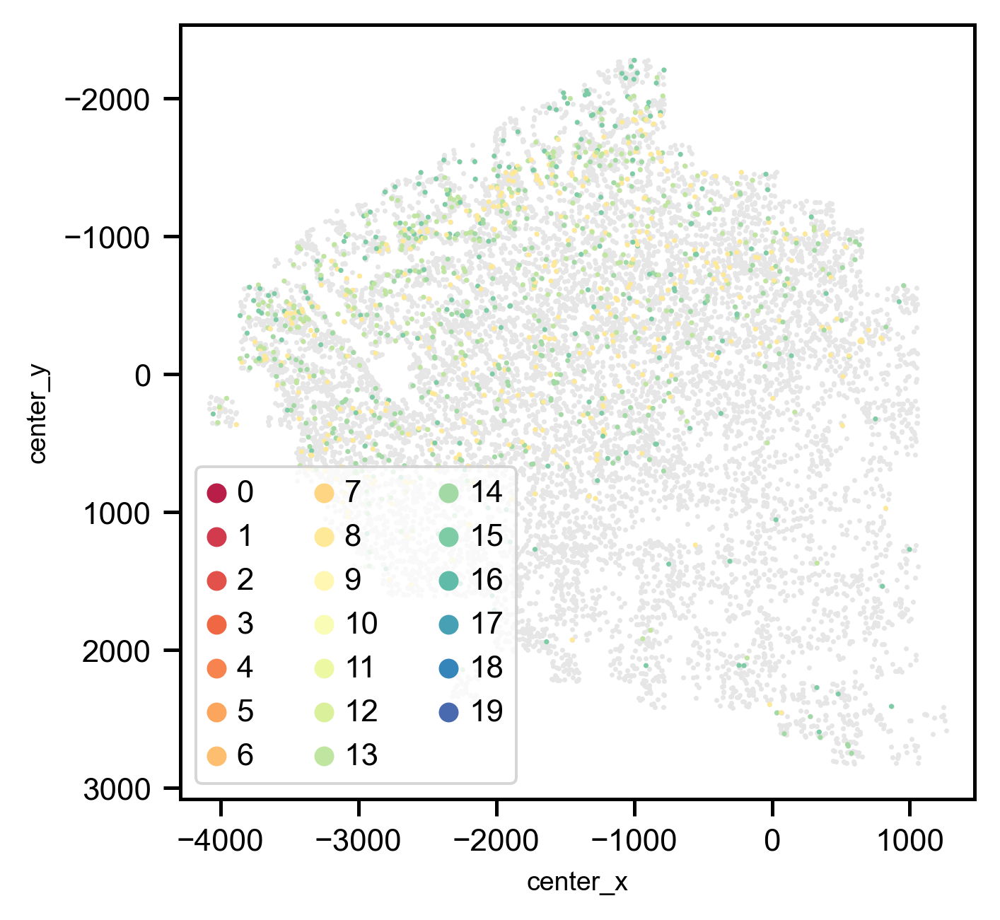

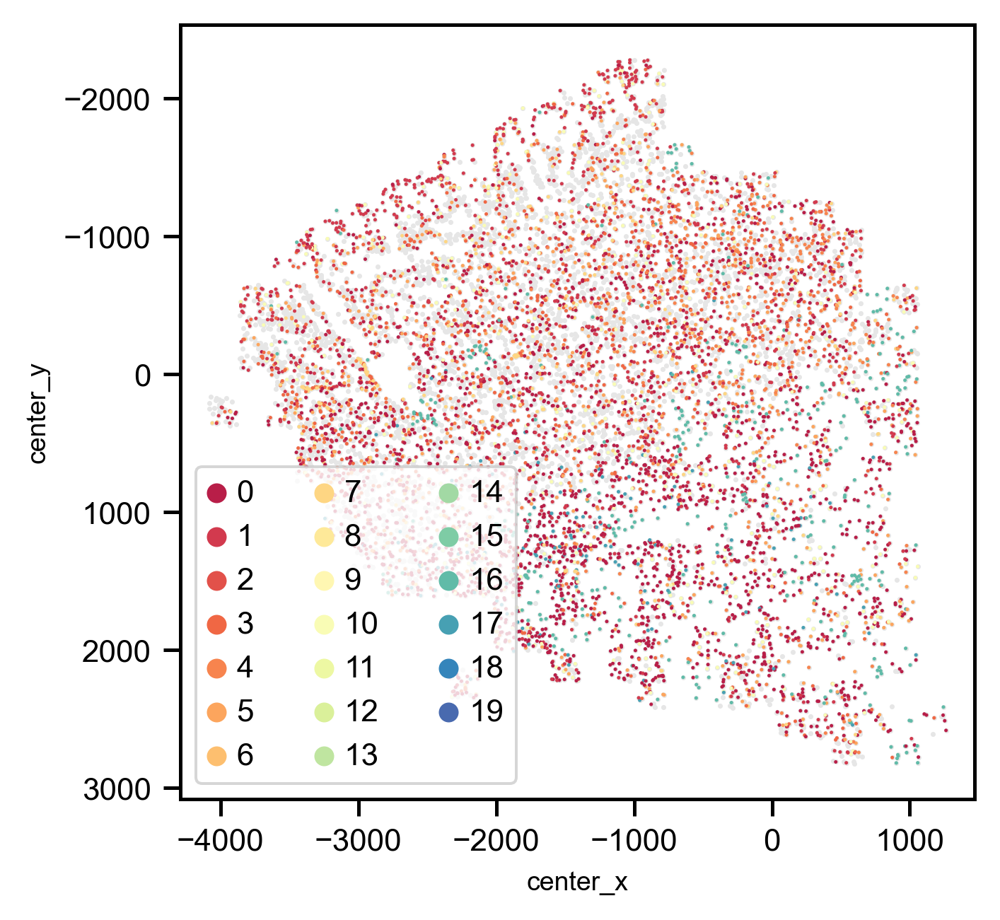

In [211]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

In [212]:
sel_experiment_id = 2
sel_obs = merged_adata.obs.loc[merged_adata.obs['experiment']==experiments[sel_experiment_id]]

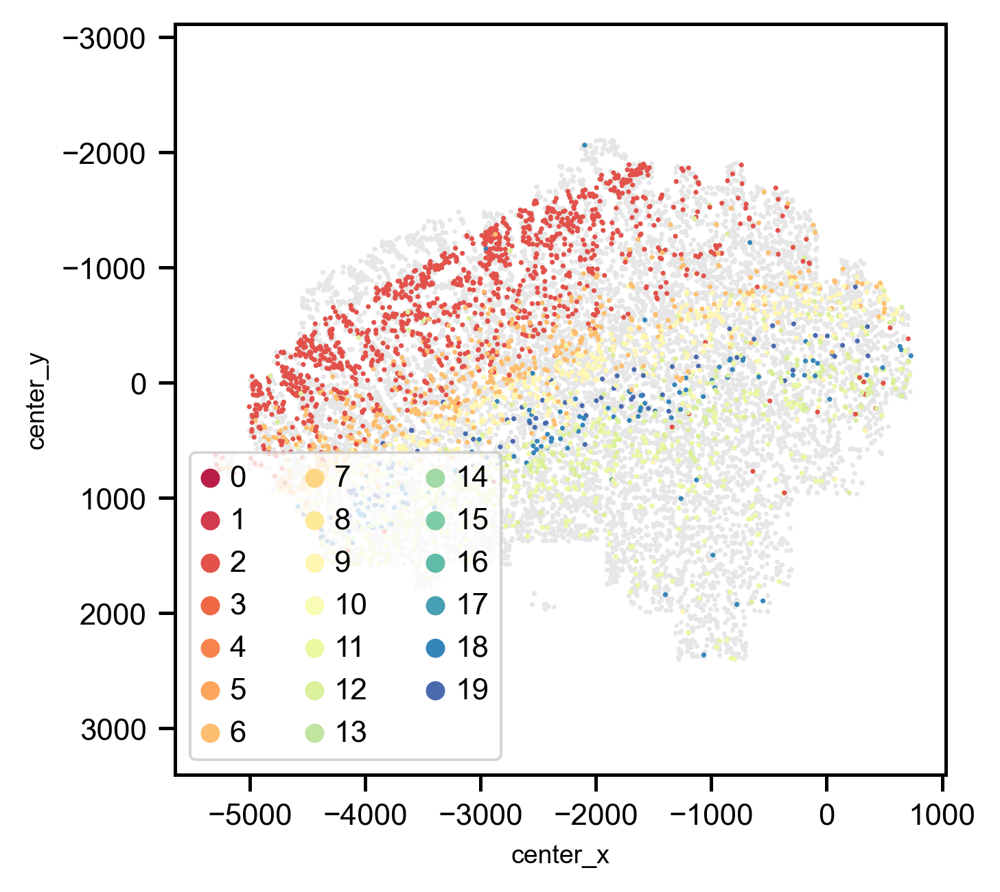

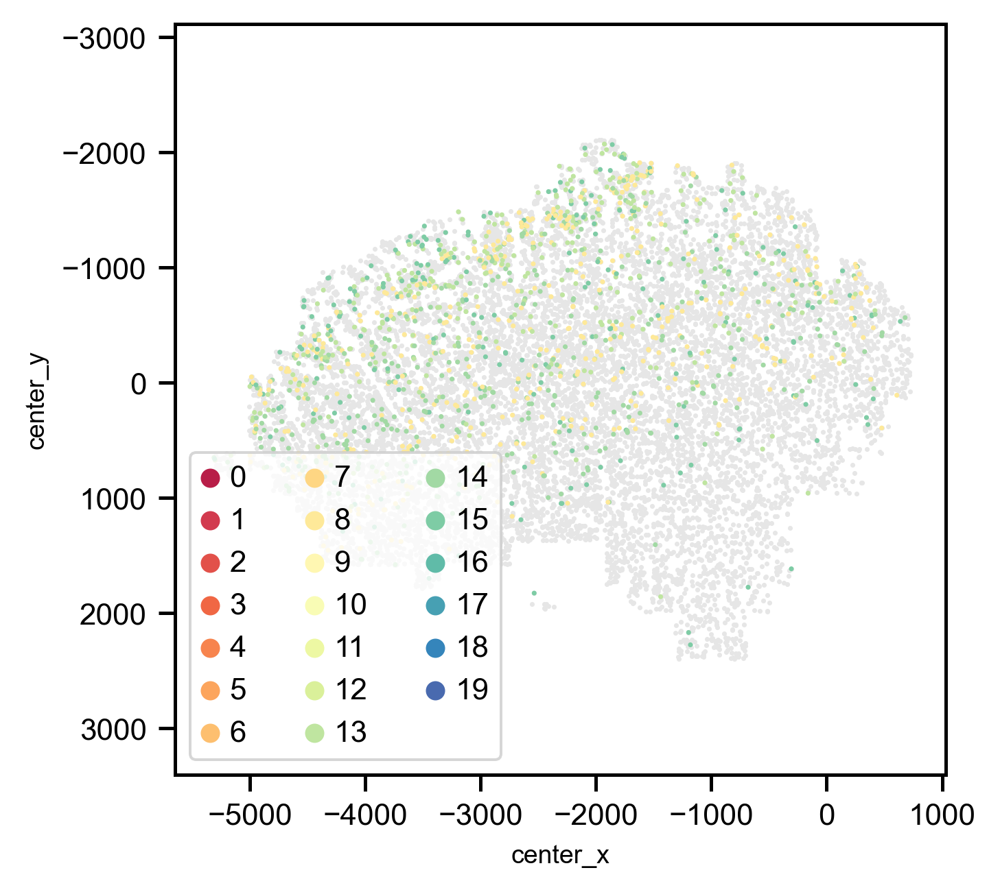

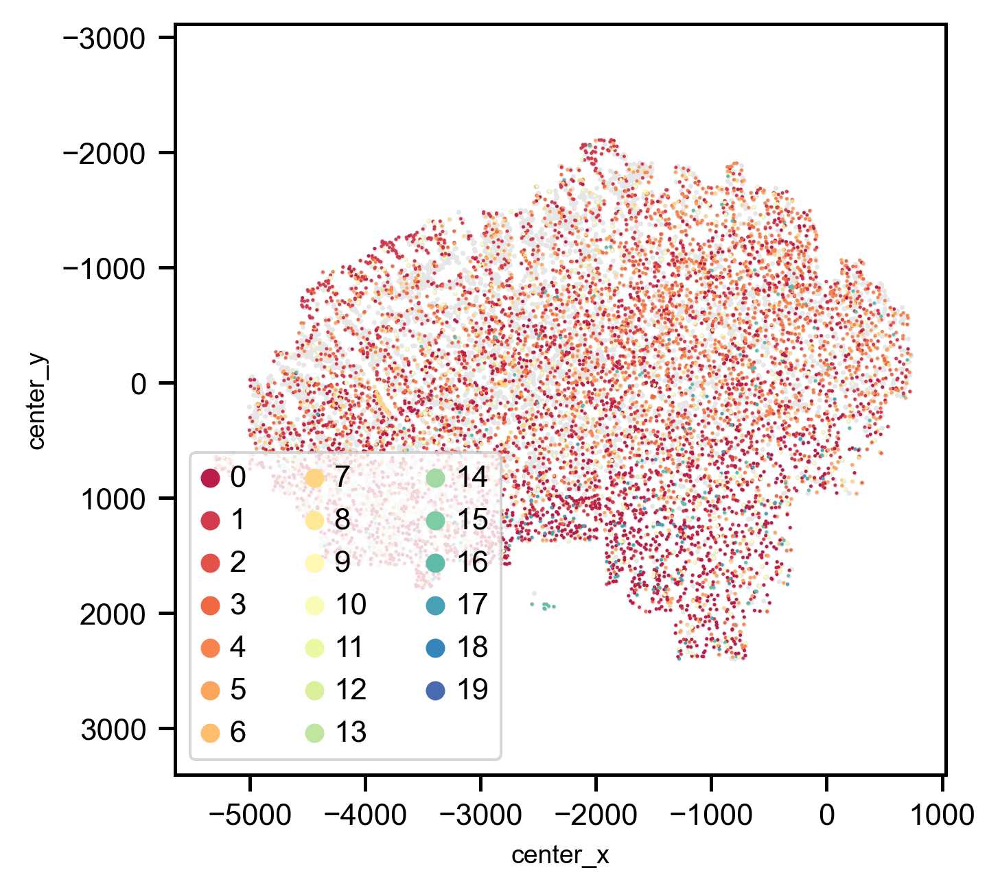

In [213]:
# visualzie the spatial dist for clusters

sel_clusters = [str(_cls) for _cls in excitatory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_excitatory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in inhibitory_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=2, legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_inhibitory_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()


sel_clusters = [str(_cls) for _cls in nonneuron_clusters]
sel_inds = [_i for _i, _cls in zip(sel_obs.index, sel_obs['leiden_cluster']) if str(_cls) in sel_clusters]

ax1 = sns.scatterplot(data=sel_obs, x='center_x', y='center_y', 
                      color=[0.9,0.9,0.9], s=2, legend=True, linewidth=0)

ax = sns.scatterplot(data=sel_obs.loc[sel_inds], x='center_x', y='center_y', 
                     palette='Spectral', #palette='tab20',
                     hue='leiden_cluster', s=1., legend=True, linewidth=0)
ax.grid(False)
ax.invert_yaxis()
plt.axis('equal')
hs, ls = ax.get_legend_handles_labels()
ax.legend(hs,ls, ncol=3, loc=3)
#plt.xlim([2250,3850])
#plt.ylim([-1600,0])
plt.savefig(os.path.join(figure_folder, f'spatial_nonneuron_clusters_{experiments[sel_experiment_id]}.png'), transparent=True)
plt.show()

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [214]:

save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: \\10.245.74.158\Chromatin_NAS_8\MERFISH\human\hM1_hM1_summary\filtered_cluster_data.h5ad


# Run classifier

## cleanup downloaded data

downloaded from:
https://portal.brain-map.org/atlases-and-data/rnaseq/human-m1-10x


In [215]:
# Only run this for the first time!
overwrite = False
seq_ref_folder = r'\\10.245.74.158\Chromatin_NAS_8\MERFISH\human\10xM1'
# adata file
sel_seq_raw_filename = os.path.join(seq_ref_folder, 'sel_hM1_10x_raw.h5ad')
# load
sel_seq_adata = sc.read_h5ad(sel_seq_raw_filename)

In [219]:
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(sel_seq_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(sel_seq_adata)
# Regress out total counts
sc.pp.regress_out(sel_seq_adata, 'total_counts')

## if processed 10x data not exits, go to jupyter:
/Merfish_Analysis_Scripts/post_analysis/Process_hM1_10x_seq_data.ipynb
        

# MLP

In [220]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as utils_data
from torch.autograd import Variable
import torch.optim as optim
#cell_by_gene = Variable(torch.Tensor(x.values))

In [225]:
class MLP_classifier(nn.Module):
    """MLP classfier"""
    def __init__(self, n_inputs, hidden_size, n_classes):
        super().__init__()
        # self params
        self.hidden_size = hidden_size
        self.n_classes = n_classes
        # Create fully connected layers
        self.l1 = nn.Linear(n_inputs, hidden_size)
        self.l2 = nn.Linear(hidden_size, hidden_size)
        self.l3 = nn.Linear(hidden_size, n_classes)
        
    def forward(self, x, activation_func='relu', classification_func='log_softmax'):
        """Apply these layers """
        _activation_func = getattr(F, activation_func)
        _classification_func = getattr(F, classification_func)
        # x = x.view(-1, n_inputs)
        x = _activation_func(self.l1(x))
        x = _activation_func(self.l2(x))
        x = _activation_func(self.l3(x))
        x = _classification_func(x, dim=1)
        return x
    
def train_mlpc(model, train_loader, optimizer='Adam', loss_func='MSELoss', 
               learing_rate=1e-3, num_epoch=256, device=None):
    
    model.train()
    if not hasattr(model, 'loss_records'):
        setattr(model, 'loss_records', [])
    if not hasattr(model, 'acc_records'):
        setattr(model, 'acc_records', [])
    
    _optimizer = getattr(optim, optimizer)(model.parameters(), lr=learing_rate)
    _loss_func = getattr(nn, loss_func)()
    # default device
    if device == None:
        device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    
    for epoch in range(num_epoch):
        # init loss
        total_loss = 0.
        n_total = 0.
        n_correct = 0.
        # loop
        for _batch_ind, (data, target) in enumerate(train_loader):
            # make prediction based on current model
            _tr_x, _tr_y = data.to(device), target.to(device)
            _pred = model(_tr_x)
            # calculate loss
            _loss = _loss_func(_pred, F.one_hot(_tr_y, model.n_classes).float() )
            total_loss += _loss
            # init grad
            _optimizer.zero_grad()
            # propagate backward
            _loss.backward()
            # optimize parameters
            _optimizer.step()
            # store info for accuracy calculation
            n_total += _tr_y.size(0)
            n_correct += (_pred.argmax(-1) == _tr_y).sum().item()
        # append
        model.loss_records.append(total_loss.cpu().item())
        model.acc_records.append(n_correct/n_total)
        # print message
        if epoch % 5 == 0:
            _test_acc = test_mlpc(model, test_data_loader)
            print (f'Epoch [{epoch+1}/{num_epoch}]\tLoss: {total_loss:.4f}\tACC: {n_correct/n_total:.4f}')
            print(_test_acc)
            
            
def test_mlpc(model, test_loader):
    # accuracy
    n_total = 0.
    n_correct = 0.
    for _batch_ind, (data, target) in enumerate(test_loader):
        # make prediction based on current model
        _tr_x, _tr_y = data.to(device), target.to(device)
        _pred = model(_tr_x)
        # store info for accuracy calculation
        n_total += _tr_y.size(0)
        n_correct += (_pred.argmax(-1) == _tr_y).sum().item()
    return n_correct / n_total


In [226]:
n_classes = len(np.unique(sel_seq_adata.obs['subclass_label'].to_list()))

subclass_2_int = {
    _c:_i for _i, _c in enumerate(np.unique(sel_seq_adata.obs['subclass_label'].to_list()))
}
subclass_ints = np.array([subclass_2_int[_c] for _c in sel_seq_adata.obs['subclass_label']], dtype=np.int32)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

pred_model = MLP_classifier(len(sel_seq_adata.var), 256, n_classes, ).to(device)

In [227]:
n_sample_train = int(inputs.size(0) * 0.9)
n_sample_test = inputs.size(0) - n_sample_train

inputs = Variable(torch.tensor(m1_10x_adata.X))
#targets = Variable(torch.Tensor(subclass_ints))
targets = Variable(torch.tensor(subclass_ints, dtype=torch.long))
all_samples = utils_data.TensorDataset(inputs, targets)
train_samples, test_samples = utils_data.random_split(all_samples, lengths=[n_sample_train, n_sample_test])


train_data_loader = utils_data.DataLoader(train_samples, batch_size=200, drop_last=False, shuffle=True)
test_data_loader = utils_data.DataLoader(test_samples, batch_size=200, drop_last=False, shuffle=True)


In [228]:
train_mlpc(pred_model, train_data_loader, num_epoch=50, learing_rate=1e-3, loss_func='CrossEntropyLoss')

Epoch [1/50]	Loss: 199.1399	ACC: 0.8320
0.8534099817089104
Epoch [6/50]	Loss: 157.9423	ACC: 0.8544
0.8569375489939901
Epoch [11/50]	Loss: 153.3258	ACC: 0.8595
0.8603344656388816
Epoch [16/50]	Loss: 151.1441	ACC: 0.8615
0.8605957669192579
Epoch [21/50]	Loss: 149.5159	ACC: 0.8628
0.8592892605173765
Epoch [26/50]	Loss: 149.1969	ACC: 0.8635
0.8605957669192579
Epoch [31/50]	Loss: 148.9445	ACC: 0.8636
0.8598118630781291
Epoch [36/50]	Loss: 150.9731	ACC: 0.8621
0.8603344656388816
Epoch [41/50]	Loss: 148.1181	ACC: 0.8640
0.8613796707603867
Epoch [46/50]	Loss: 148.1827	ACC: 0.8640
0.8615103214005748


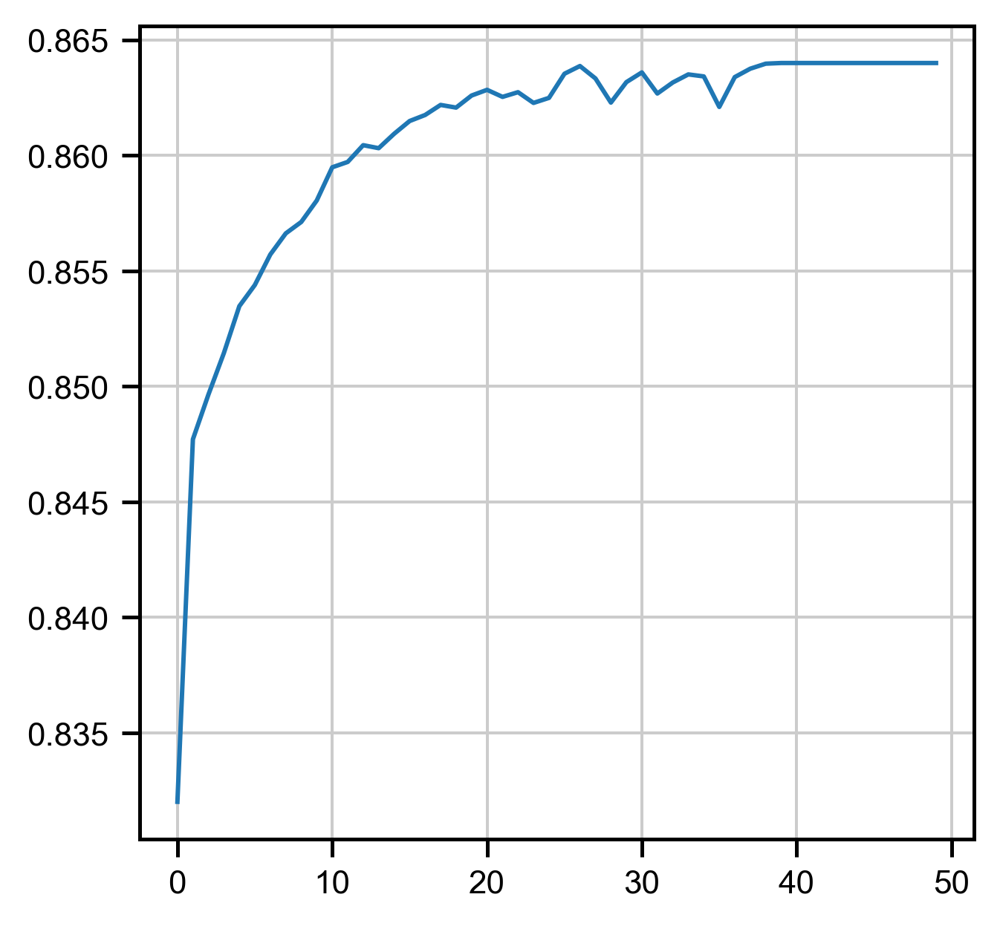

In [229]:
plt.figure()
plt.plot(pred_model.acc_records)
plt.show()

# M1adata

In [230]:
merfish_adata = sc.read_h5ad(filtered_filename)
# calculate metric
sc.pp.calculate_qc_metrics(merfish_adata, percent_top=None, log1p=False, inplace=True)
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merfish_adata, target_sum=np.median(merfish_adata.obs['total_counts']))
# Logarithmize the data
sc.pp.log1p(merfish_adata)
# Regress out total counts
sc.pp.regress_out(merfish_adata, 'total_counts')

In [231]:
pred_samples = Variable(torch.tensor(merfish_adata.X))

pred_ints = pred_model(pred_samples.to(device)).argmax(-1).cpu().numpy()

int_2_subclass = {_v:_k for _k,_v in subclass_2_int.items()}
pred_subclasses = [int_2_subclass[_pi] for _pi in pred_ints]

In [232]:
merged_adata.obs['pred_subclass'] = pred_subclasses

In [239]:
int_2_subclass

{0: 'Astro',
 1: 'Endo',
 2: 'L2/3 IT',
 3: 'L5 ET',
 4: 'L5 IT',
 5: 'L5/6 NP',
 6: 'L6 CT',
 7: 'L6 IT',
 8: 'L6 IT Car3',
 9: 'L6b',
 10: 'Lamp5',
 11: 'Micro-PVM',
 12: 'OPC',
 13: 'Oligo',
 14: 'Pvalb',
 15: 'Sncg',
 16: 'Sst',
 17: 'Sst Chodl',
 18: 'VLMC',
 19: 'Vip'}

In [238]:
np.unique(pred_ints)

array([ 0,  2,  4,  6,  9, 13, 14, 16, 17, 19], dtype=int64)

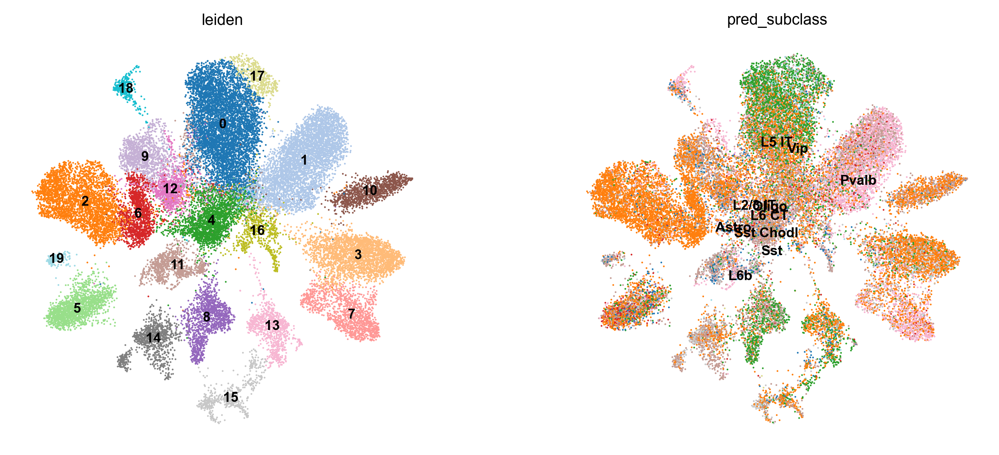

In [233]:
# Plot the UMAP
sc.pl.umap(merged_adata, color=['leiden', 'pred_subclass'], 
           legend_loc='on data',
           palette='tab20',
           save='_cluster.png',
           )

In [234]:
import sys
sys.path.append(r"..\..\..\Documents")
import ImageAnalysis3.celltype_tools.classifier as clsf

In [235]:
prediction_column = 'pred_subclass'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden'

print('Predict cell types.')
#clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')

Predict cell types.


C:\Users\puzheng_new\AppData\Local\Temp\57\ipykernel_22564\3092389796.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


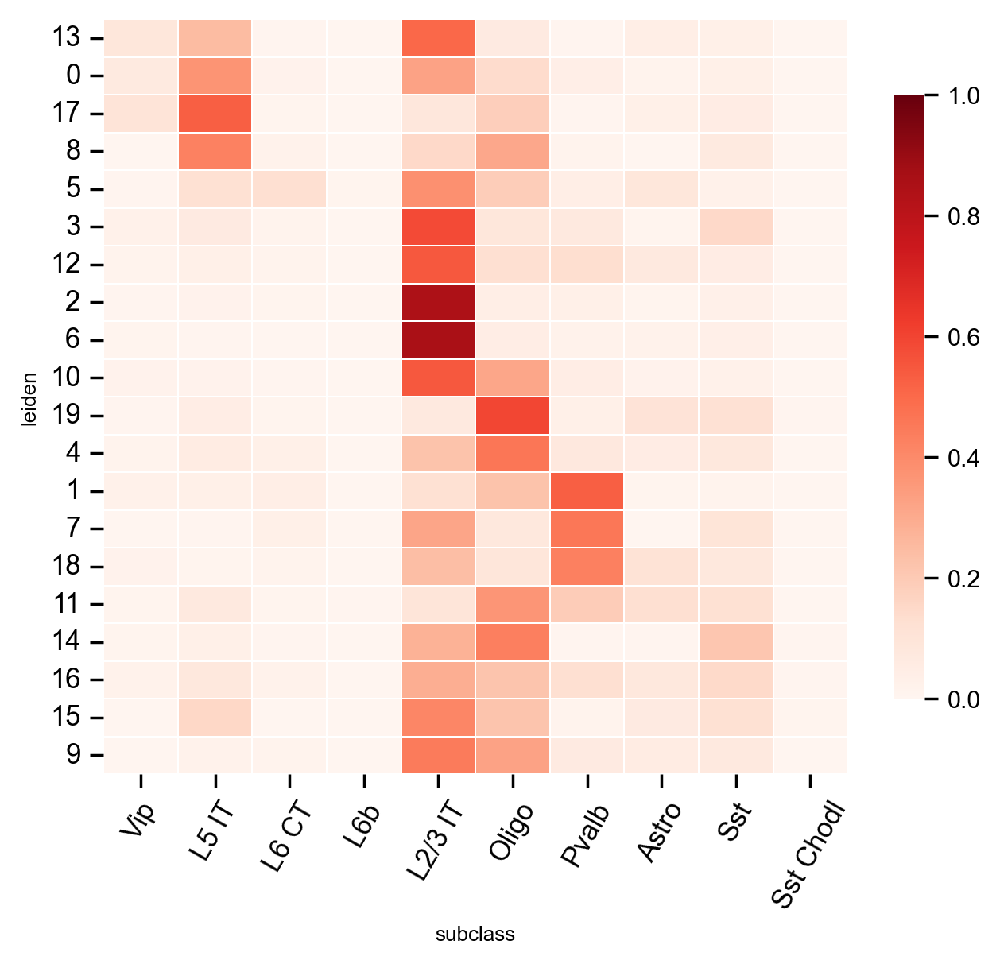

In [236]:
# Plot
fig1=plt.figure(figsize=(6,5),dpi=125)
#sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

(array([1.5537093e+07, 0.0000000e+00, 1.1757000e+04, 8.0893000e+05,
        1.2662660e+06, 1.0745490e+06, 8.2168900e+05, 3.5588300e+05,
        2.2333000e+04, 8.0000000e+01]),
 array([0.        , 0.88429326, 1.7685865 , 2.6528797 , 3.537173  ,
        4.4214664 , 5.3057594 , 6.190053  , 7.074346  , 7.9586396 ,
        8.842933  ], dtype=float32),
 <BarContainer object of 10 artists>)

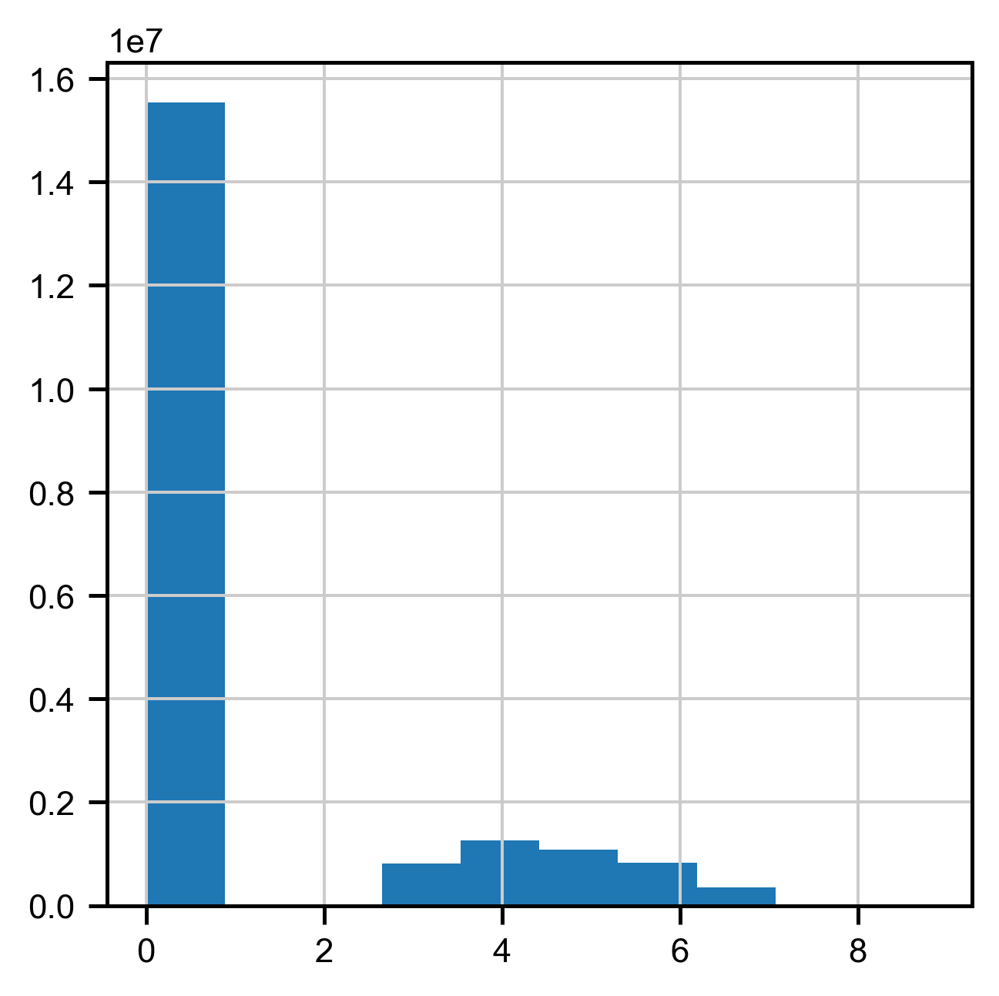

In [172]:
plt.hist(np.ravel(sel_seq_adata.X))

(array([7.796433e+06, 3.793920e+05, 2.168320e+05, 1.241070e+05,
        7.040400e+04, 2.991800e+04, 1.227600e+04, 3.482000e+03,
        8.760000e+02, 1.000000e+02]),
 array([0.        , 0.41556692, 0.83113384, 1.2467008 , 1.6622677 ,
        2.0778346 , 2.4934015 , 2.9089684 , 3.3245354 , 3.7401023 ,
        4.155669  ], dtype=float32),
 <BarContainer object of 10 artists>)

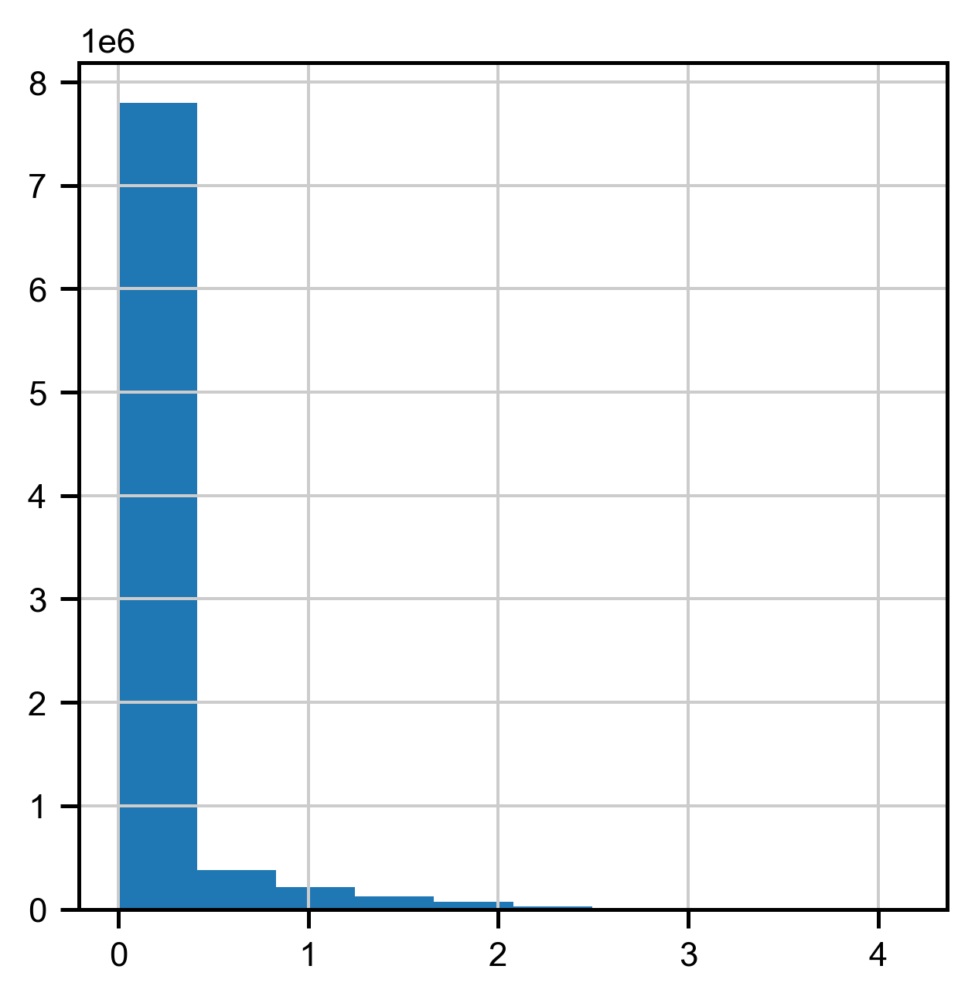

In [171]:
plt.hist(np.ravel(merfish_adata.X))